In [2]:
import pandas as pd # Library for data handling
import numpy as np # matrix operations
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sb
plt.rcParams['figure.figsize'] = (20, 12)
import folium
import branca as bc
from mapclassify import classify


In [36]:
rm1 = pd.read_csv('rm_crop_yields_1938_2021.csv')

In [4]:
map1 = gpd.read_file('Rural Municipality/Rural Municipality.shp')

In [37]:
rm1.head()

,Year,RM,Winter Wheat,Canola,Spring Wheat,Mustard,Durum,Sunflowers,Oats,Lentils,Peas,Barley,Fall Rye,Canary Seed,Spring Rye,Tame Hay,Flax,Chickpeas
0,1938,1,NaN,NaN,4.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,0.0,NaN
1,1939,1,NaN,NaN,9.0,NaN,NaN,NaN,16.0,NaN,NaN,16.0,NaN,NaN,NaN,NaN,0.0,NaN
2,1940,1,NaN,NaN,12.0,NaN,NaN,NaN,23.0,NaN,NaN,19.0,NaN,NaN,NaN,NaN,8.0,NaN
3,1941,1,NaN,NaN,18.0,NaN,NaN,NaN,32.0,NaN,NaN,28.0,NaN,NaN,NaN,NaN,5.0,NaN
4,1942,1,NaN,NaN,20.0,NaN,NaN,NaN,35.0,NaN,NaN,28.0,14.0,NaN,NaN,NaN,5.0,NaN


In [38]:
rm1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25017 entries, 0 to 25016
Data columns (total 18 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Year          25017 non-null  int64  
 1   RM            25017 non-null  int64  
 2   Winter Wheat  3037 non-null   float64
 3   Canola        14008 non-null  float64
 4   Spring Wheat  24924 non-null  float64
 5   Mustard       4487 non-null   float64
 6   Durum         11581 non-null  float64
 7   Sunflowers    946 non-null    float64
 8   Oats          23913 non-null  float64
 9   Lentils       5515 non-null   float64
 10  Peas          8134 non-null   float64
 11  Barley        24703 non-null  float64
 12  Fall Rye      15847 non-null  float64
 13  Canary Seed   3819 non-null   float64
 14  Spring Rye    805 non-null    float64
 15  Tame Hay      4205 non-null   float64
 16  Flax          20934 non-null  float64
 17  Chickpeas     960 non-null    float64
dtypes: float64(16), int64(2)
m

In [8]:
map1.head()

,PPID,EFFDT,EXPDT,FEATURECD,RMNO,RMNM,SHAPE_AREA,SHAPE_LEN,geometry
0,0101000095,2019-01-21,NaN,RMPPID,095,GOLDEN WEST,8.101431e+08,265851.388799,"POLYGON ((654081.000 5546088.320, 654885.320 5..."
1,0101000378,2019-07-29,NaN,RMPPID,378,ROSEMOUNT,5.844701e+08,161271.937167,"POLYGON ((265258.740 5810148.180, 266062.740 5..."
2,0101000288,2015-01-27,NaN,RMPPID,288,PLEASANT VALLEY,8.532007e+08,116895.097209,"POLYGON ((254141.490 5701256.420, 254179.510 5..."
3,0101000106,2019-04-24,NaN,RMPPID,106,WHISKA CREEK,8.526283e+08,129288.281136,"POLYGON ((339874.810 5539057.770, 339849.430 5..."
4,0101000132,2019-07-16,NaN,RMPPID,132,HILLSBOROUGH,6.343913e+08,103052.690196,"POLYGON ((445175.620 5573313.600, 445572.880 5..."


In [9]:
map1.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 298 entries, 0 to 297
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   PPID        298 non-null    object  
 1   EFFDT       298 non-null    object  
 2   EXPDT       0 non-null      float64 
 3   FEATURECD   298 non-null    object  
 4   RMNO        298 non-null    object  
 5   RMNM        298 non-null    object  
 6   SHAPE_AREA  298 non-null    float64 
 7   SHAPE_LEN   298 non-null    float64 
 8   geometry    298 non-null    geometry
dtypes: float64(3), geometry(1), object(5)
memory usage: 21.1+ KB


In [21]:
map1.explore(
    column='SHAPE_AREA',    
    cmap='Blues',
    scheme='quantiles',
    legend=True,
    tiles ='open street map')


In [39]:
# create a new data frame for RM 232
rm2 = rm1[rm1['RM'] == 232]



In [40]:
rm2.head()

,Year,RM,Winter Wheat,Canola,Spring Wheat,Mustard,Durum,Sunflowers,Oats,Lentils,Peas,Barley,Fall Rye,Canary Seed,Spring Rye,Tame Hay,Flax,Chickpeas
11927,1938,232,NaN,NaN,6.0,NaN,NaN,NaN,10.0,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,NaN
11928,1939,232,NaN,NaN,9.0,NaN,NaN,NaN,11.0,NaN,NaN,19.0,NaN,NaN,NaN,NaN,NaN,NaN
11929,1940,232,NaN,NaN,17.0,NaN,NaN,NaN,25.0,NaN,NaN,25.0,NaN,NaN,NaN,NaN,6.0,NaN
11930,1941,232,NaN,NaN,7.0,NaN,NaN,NaN,10.0,NaN,NaN,10.0,NaN,NaN,NaN,NaN,2.0,NaN
11931,1942,232,NaN,NaN,17.0,NaN,NaN,NaN,27.0,NaN,NaN,26.0,8.0,NaN,NaN,NaN,7.0,NaN


<AxesSubplot:xlabel='Year'>

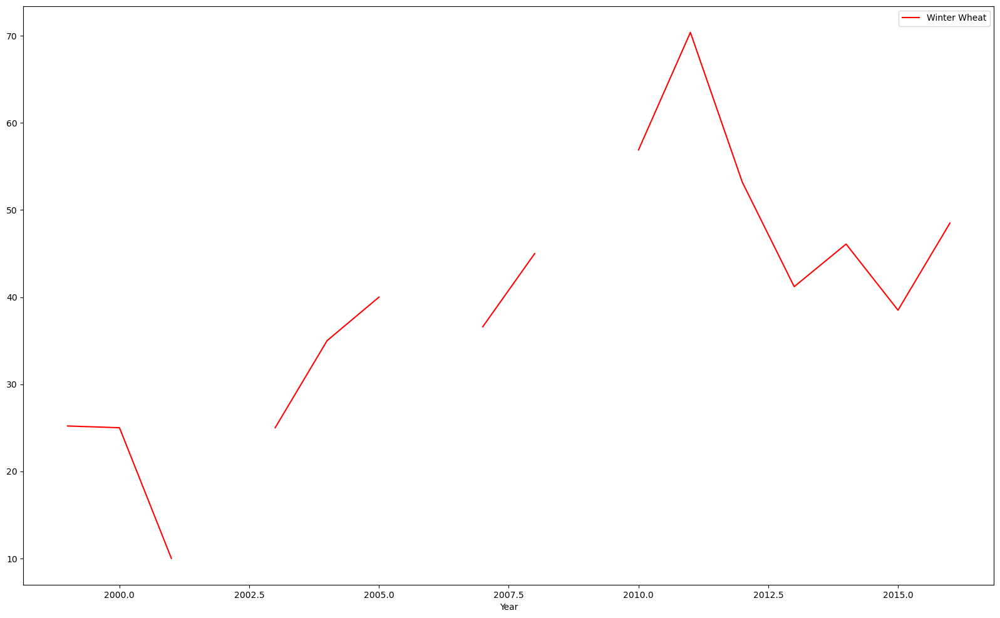

In [41]:
# plot a line graph with rm1 data for crop yield for the year 
rm2.plot(x='Year', y='Winter Wheat', kind='line', figsize=(20, 12), color='red')


In [47]:
rm2_mean = rm2.groupby('Year').mean()

#remove the column RM
rm2_mean = rm2_mean.drop(columns=['RM'])


In [48]:
rm2_mean

,Winter Wheat,Canola,Spring Wheat,Mustard,Durum,Sunflowers,Oats,Lentils,Peas,Barley,Fall Rye,Canary Seed,Spring Rye,Tame Hay,Flax,Chickpeas
Year,,,,,,,,,,,,,,,,
1938,NaN,NaN,6.00,NaN,NaN,NaN,10.0,NaN,NaN,15.00,NaN,NaN,NaN,NaN,NaN,NaN
1939,NaN,NaN,9.00,NaN,NaN,NaN,11.0,NaN,NaN,19.00,NaN,NaN,NaN,NaN,NaN,NaN
1940,NaN,NaN,17.00,NaN,NaN,NaN,25.0,NaN,NaN,25.00,NaN,NaN,NaN,NaN,6.0,NaN
1941,NaN,NaN,7.00,NaN,NaN,NaN,10.0,NaN,NaN,10.00,NaN,NaN,NaN,NaN,2.0,NaN
1942,NaN,NaN,17.00,NaN,NaN,NaN,27.0,NaN,NaN,26.00,8.0,NaN,NaN,NaN,7.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017,NaN,30.0,33.97,691.53,37.33,NaN,NaN,1001.28,29.7,41.53,NaN,NaN,NaN,NaN,NaN,NaN
2018,NaN,38.0,32.00,793.00,29.00,NaN,NaN,1015.00,29.0,47.00,NaN,NaN,NaN,NaN,NaN,1076.0
2019,NaN,21.2,28.00,421.00,24.50,NaN,NaN,463.00,18.4,35.80,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:xlabel='Year'>

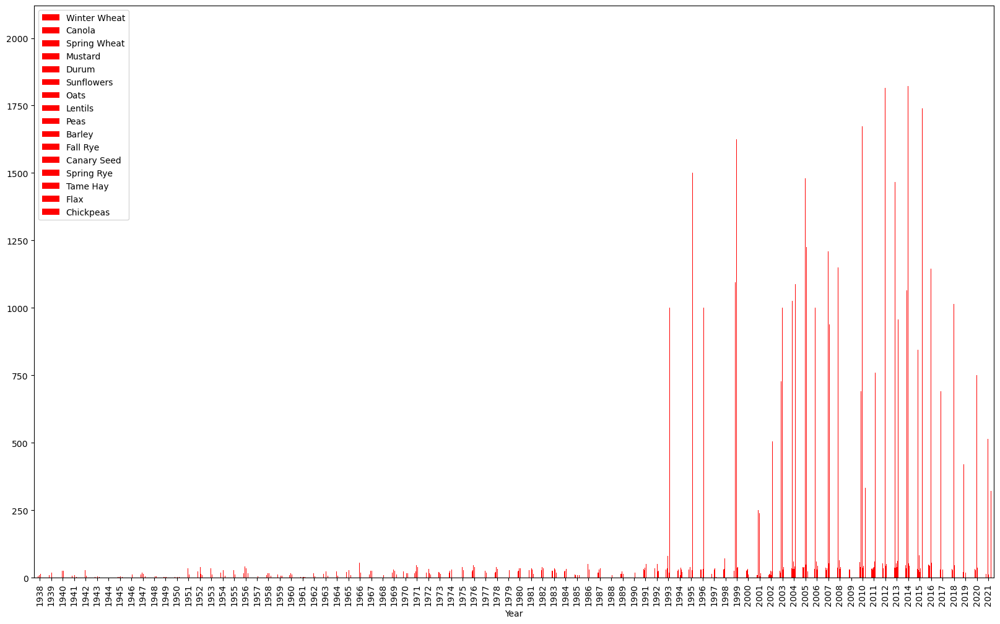

In [49]:
# create a plot for the mean of all crops
rm2_mean.plot(kind='bar', figsize=(20, 12), color='red')

In [51]:
# create a new data frame for the top ten years with highest mean crop yield  for winter wheat 
rm2_mean_top10 = rm2_mean.nlargest(10, 'Winter Wheat')


In [52]:
rm2_mean_top10

,Winter Wheat,Canola,Spring Wheat,Mustard,Durum,Sunflowers,Oats,Lentils,Peas,Barley,Fall Rye,Canary Seed,Spring Rye,Tame Hay,Flax,Chickpeas
Year,,,,,,,,,,,,,,,,
2011,70.40,31.70,35.70,1164.00,31.30,NaN,36.60,1848.00,39.3,59.70,49.10,760.00,NaN,NaN,NaN,NaN
2010,56.90,38.80,33.60,690.00,29.10,NaN,65.00,1673.00,38.2,49.40,44.00,951.00,NaN,NaN,NaN,333.00
2012,53.20,32.20,35.30,NaN,40.50,NaN,NaN,1816.00,43.6,54.80,50.00,1026.00,NaN,NaN,NaN,NaN
2016,48.50,43.90,45.90,1321.00,43.20,NaN,62.40,1145.00,42.3,54.80,55.90,NaN,NaN,NaN,NaN,NaN
2014,46.09,37.16,35.18,1065.62,31.13,0.0,NaN,1821.47,31.9,54.19,43.44,736.34,0.0,0.0,NaN,NaN
2008,45.00,37.50,36.10,1150.00,36.60,NaN,65.00,NaN,33.0,55.60,40.00,1125.00,NaN,NaN,NaN,NaN
2013,41.20,37.90,36.60,1466.00,37.90,NaN,52.70,2019.00,39.9,61.50,38.30,958.00,NaN,NaN,NaN,NaN
2005,40.00,40.70,36.20,1175.00,40.60,NaN,47.50,1480.00,39.6,49.00,48.50,1225.00,NaN,NaN,23.0,1250.00
2015,38.50,32.34,29.74,845.31,27.61,NaN,84.16,1376.82,20.7,59.41,33.98,NaN,NaN,NaN,NaN,1739.43


In [67]:
rm3 = rm2.groupby('Year')['Winter Wheat'].mean().sort_values(ascending=True).head(3)

In [68]:
rm3 

Year
2001    10.0
2000    25.0
2003    25.0
Name: Winter Wheat, dtype: float64

In [71]:
rm4 = rm1.groupby('RM')['Spring Wheat'].mean().sort_values(ascending=False).head(10)

In [72]:
rm4

RM
429    33.299643
333    32.889881
428    32.717381
271    32.582976
427    32.517143
368    32.492857
458    32.223571
369    31.980357
303    31.652619
273    31.503333
Name: Spring Wheat, dtype: float64

In [73]:
rm4.info

<bound method Series.info of RM
429    33.299643
333    32.889881
428    32.717381
271    32.582976
427    32.517143
368    32.492857
458    32.223571
369    31.980357
303    31.652619
273    31.503333
Name: Spring Wheat, dtype: float64>